## BWDB Non-Tidal Water Level Stations (Daily Average Calculation)

In [3]:
import mikeio
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import os
import glob
from datetime import datetime, timedelta
from calendar import monthrange



# Defining a fuction to create a equidistant blank timeseries dataframe
def equi_ts_dataframe(dataframe):
    
    df = dataframe

    # Defining a dataframe to store the equidistant timeseries dataframe
    total_time_df = pd.DataFrame()

    # Finding the oldest and most recent year of the input timeseries
    start_yr = df['Date'].dt.year.unique().min()
    end_yr = df['Date'].dt.year.unique().max()

    # Creating a list containing all the year (@ 1 year increment) from oldest to most recent
    year_list = [y for y in range(start_yr, end_yr+1 , 1)]

    # Looping through the year list to create an equi distant time series dataframe
    for yr in year_list:

        # Creating a list containing all the month of a year
        months_list = [m for m in range(1, 12+1 , 1)]

        # Defining a dataframe to store the yearly equidistant timeseries
        yearly_time_df = pd.DataFrame()

        # Looping through the month list to create the equidistant timeseries dataframe
        for month in months_list:

            # finding the end date of the month
            end_day = monthrange(yr, month)[1]

            # Setting the srart and end date of the month
            start_date = (datetime(year= yr, month= month, day=1, hour=0, minute=0, second =0)).strftime('%Y-%m-%d %H:%M:%S')
            end_date = (datetime(year= yr, month= month, day= end_day, hour=23, minute=30, second =0)).strftime('%Y-%m-%d %H:%M:%S')

            # Generating an equidistant timeseries dataframe (@ daily interval)
            monthly_time_list = pd.date_range(start_date, end_date, freq="1D")

            # Creating the monthly dataframe with column name "Date"
            monthly_time_df = pd.DataFrame({'Date':monthly_time_list})
            monthly_time_df['Date'] = monthly_time_df['Date'].dt.strftime('%d/%m/%Y')

            # Updating the monthly dataframe to the yearly dataframe
            yearly_time_df = pd.concat([yearly_time_df,monthly_time_df])

        #Updating the total timeseries dataframe with the yearly dataframe
        total_time_df = pd.concat([total_time_df,yearly_time_df])

    return total_time_df


for file in glob.glob(r"G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\dfs0\*.dfs0"):
    
    try:
        # Spliting the file path by spearator to create a path list
        path_list = file.split(os.sep)

        # reading the dfs0 file
        dfs = mikeio.read(file)

        # Converting the dfs0 file, resetting the index, renaming the column and sorting it [Oldest to Newest]
        df = dfs.to_dataframe()
        df.reset_index(inplace = True)
        df.rename(columns ={'index':'Date'},inplace = True)
        df.sort_values(by='Date',ascending=True, inplace = True)

        # Creating an equidistant datetime timeseries (@ daily interval)
        total_time_df = equi_ts_dataframe(df)

        # Droping the "Date" duplicate rows and keeping the first value from duplicate rows
        without_duplicate_df = df.drop_duplicates(subset=['Date'], keep='first')

        # Creating a daily avearage dataframe from the duplicate free dataframe and 
        # resetting the index to get the "Date" column and formatting the "Date" as (dd/mm/yyyy) format
        davg_df = without_duplicate_df.groupby(by=without_duplicate_df['Date'].dt.date).mean()
        davg_df.reset_index(drop=False, inplace = True)
        davg_df['Date'] = pd.to_datetime(davg_df['Date']).dt.strftime('%d/%m/%Y')

        # Merging daily blank timeseries dataframe and 
        # processed (from input timeseries) daily mean water level dataframe together
        equi_davg_df = total_time_df.merge(davg_df, how="outer", on="Date")

        # Saving the equidistant daily average timeseries dataframe
        equi_davg_df.to_excel(r'G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\Daily_Avg\{}_Daily_Avg_WL.xlsx'.format(path_list[-1][:-5]), 
                         float_format="%.4f", index = None)

        print(path_list[-1][:-5])
    
    except:
        print('!!!!Error!!! ' + path_list[-1][:-5])

SW10 (Simulbari)
SW101 (Kamarkhali Transit)
SW101.5 (Kamarkhali_Gondhakhali)
SW109 (Bibir Bazar)
SW11 (Khanpur)
SW11.5 (Nalkasengati)
SW110 (Cumilla)
SW113 (Kangsanagar)
SW114 (Jibanpur_Gumti)
SW117 (Narayanhat)
SW119.1 (Panchpukuria)
SW11A (Shariakandi)
SW12 (Madhupur)
SW123 (Gangasagar Rly.)
SW124 (Thandachari)
SW13 (Kawaljani)
SW131.5 (Laurergarh Saktiarkhola)
SW132 (Manmathpur)
SW132.2 (Phulbari)
SW132.5 (Joypurhat)
SW133 (Naogaon)
SW134 (Jukerchar)
SW134A (Baushi Bridge)
SW134B (Offtake of Jhenai)
SW135A (Juricont_Silghat)
SW137A (Taraghat)
SW138 (Sofiabad)
SW139 (Bardeswari)
SW14 (Mirzapur_Bangshi)
SW140 (Panchagarh)
SW141 (Debiganj)
SW142 (Khansama)
SW142.1 (Bhushirbandar)
SW143 (Shamjhiaghat)
SW144 (Chak Hariharpur)
SW145 (Mohadebpur)
SW147 (Atrai Rly. Bridge)
SW147.5 (Singra)
SW148 (Chanchkair)
SW149 (Astamanisha)
SW149.1 (Gumani Rly. Bridge)
SW150 (Dohakoladanga)
SW151 (Baghabari)
SW155 (Mohimaganj Railway Crossing)
SW156A (Kundal)
SW157 (Ballah)
SW158 (Chunarghat)
SW158.1 (S

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import os
import glob

e_df = pd.DataFrame()

for file in glob.glob(r'G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\Daily_Avg\test\*.xlsx'):
    
    try:
        path_list = file.split(os.sep)

        df = pd.read_excel(file)

        #Exceedance Probability Calculation
        
        col_name = 'Data for Analysis (mMSL)'

        df.dropna(subset=[col_name],inplace = True)
        df.sort_values(by = col_name, ascending=False, inplace = True)
        df['Ranking'] = df[col_name].rank(method='min', ascending=False)
        df['Exceedence Probability (%)'] = (df.loc[:,'Ranking']*100)/(len(df[col_name])+1)


        # Exceedance Probability Plotting

        font={'family':'Times New Roman',
             'weight':'normal',
             'size':5.5}

        plt.rc('font',**font)
        plt.rc('xtick',labelsize=5)
        plt.rc('ytick',labelsize=5)

        plt.figure(figsize=(5,3),dpi=300)

        x_axis = df['Exceedence Probability (%)']  # input
        y_axis = df[col_name]                # input

        plt.plot(x_axis, y_axis,lw=1,color='blue',label='Daily Mean Water Level (DMWL)')
        plt.minorticks_on()

        ytic_round_value = 3
        y_low = y_axis.min() - (y_axis.min())% ytic_round_value-2
        y_high = y_axis.max() + (ytic_round_value - (y_axis.max())% ytic_round_value)+1
        # low,high=round(df3['WL (mMSL)'].min())-1,round(df3['WL (mMSL)'].max())+1



        plt.legend(bbox_to_anchor=(0.98, 0.98), loc=1, borderaxespad=0)

        plt.xticks(np.arange(0,100+1,10))
        plt.yticks(np.arange(y_low,y_high+1,ytic_round_value))

        plot_title = 'Exceedance Probability of Daily Mean Water Level at {}'.format(path_list[-1][:-18])     # name needs to be changed
        plt.title(plot_title, fontweight= 'roman', fontsize = 8)
        plt.xlabel('Exceedance Probability (%)', fontweight= 'roman', fontsize = 7)
        plt.ylabel('Daily Mean Water Level (mMSL)', fontweight= 'roman', fontsize = 7)

        plt.xlim([0, 100])
        plt.ylim([y_low, y_high])


        xvals = [5, 95]
        yinterp = np.interp(xvals, x_axis, y_axis)


        # Update 5% and 95% WL value in the final Excel

        prob_df = pd.DataFrame({'Station Name': path_list[-1][:-18], 'Exceedance Probability (%)':xvals, 
                                   'WL (mMSL)': list(yinterp) })

        e_df = pd.concat([e_df,prob_df])


        # Adding 5% and 95% WL Points in the figure
        plt.plot(xvals, yinterp, 'o', color='r', markersize=3)


        # draw dash lines for 5% exceedance level
        plt.plot([xvals[0],100], [yinterp[0], yinterp[0]], '--', color='k', lw=0.7, alpha = 0.7)

        anot_label_1 = 'Standard High Water Level = (+) {b} mMSL [5% Exceedance DMWL]'.format(a=xvals[0],
                                                                                              b = "%.2f" % yinterp[0])

        plt.annotate(anot_label_1, (25, yinterp[0]+0.25*(y_high-y_low)/(22-7)), color='k',weight = 'bold', style='italic')


        # draw dash lines for 95% exceedance level
        plt.plot([0, xvals[1]], [yinterp[1], yinterp[1]], '--', color='k', lw=0.7, alpha = 0.7)

        anot_label_2 = 'Standard Low Water Level = (+) {b} mMSL [95% Exceedance DMWL]'.format(a=xvals[1],
                                                                                              b = "%.2f" % yinterp[1])

        plt.annotate(anot_label_2, (25, yinterp[1]-0.6*(y_high-y_low)/(22-7)), color='k',weight = 'bold', style='italic')



        #Saving the figure
        # plt.savefig(r"{}.jpg".format('test'), bbox_inches='tight')
        plt.savefig(r"G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\Plot\{}_EP.jpg".format(path_list[-1][:-5]), 
                    bbox_inches='tight')


        # Saving Exccedence Probability Calculation
        ep_cal_df = df[['Date',col_name,'Ranking','Exceedence Probability (%)']]
        ep_cal_df.to_excel(r"G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\EP_Calculation\{}_EP.xlsx".format(path_list[-1][:-5]), 
                           float_format="%.4f")
    
        print(path_list[-1][:-5])
        
        
    except:
        print('Error!!_' + path_list[-1][:-5])


# Saving 5% and 95% Exceedance Probability Plot of Input Station
e_df.to_excel(r"G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\BWDB_Non_Tidal_Stations_SHWL_and_SLWL.xlsx", 
              float_format="%.4f", index = None)

In [9]:
len('_Daily_Avg_WL.xlsx')

18

SW10 (Simulbari)_Daily_Avg_WL
SW101 (Kamarkhali Transit)_Daily_Avg_WL
SW101.5 (Kamarkhali_Gondhakhali)_Daily_Avg_WL
SW109 (Bibir Bazar)_Daily_Avg_WL
SW11 (Khanpur)_Daily_Avg_WL
SW11.5 (Nalkasengati)_Daily_Avg_WL
SW110 (Cumilla)_Daily_Avg_WL
SW113 (Kangsanagar)_Daily_Avg_WL
SW114 (Jibanpur_Gumti)_Daily_Avg_WL
SW117 (Narayanhat)_Daily_Avg_WL
SW119.1 (Panchpukuria)_Daily_Avg_WL
SW11A (Shariakandi)_Daily_Avg_WL
SW12 (Madhupur)_Daily_Avg_WL
SW123 (Gangasagar Rly.)_Daily_Avg_WL
SW124 (Thandachari)_Daily_Avg_WL
SW13 (Kawaljani)_Daily_Avg_WL
SW131.5 (Laurergarh Saktiarkhola)_Daily_Avg_WL
SW132 (Manmathpur)_Daily_Avg_WL
SW132.2 (Phulbari)_Daily_Avg_WL
SW132.5 (Joypurhat)_Daily_Avg_WL


C:\Users\MDS\anaconda3\envs\py377\lib\site-packages\ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


SW133 (Naogaon)_Daily_Avg_WL
SW134 (Jukerchar)_Daily_Avg_WL
SW134A (Baushi Bridge)_Daily_Avg_WL
SW134B (Offtake of Jhenai)_Daily_Avg_WL
SW135A (Juricont_Silghat)_Daily_Avg_WL
SW137A (Taraghat)_Daily_Avg_WL
SW138 (Sofiabad)_Daily_Avg_WL
SW139 (Bardeswari)_Daily_Avg_WL
SW14 (Mirzapur_Bangshi)_Daily_Avg_WL
SW140 (Panchagarh)_Daily_Avg_WL
SW141 (Debiganj)_Daily_Avg_WL
SW142 (Khansama)_Daily_Avg_WL
SW142.1 (Bhushirbandar)_Daily_Avg_WL
SW143 (Shamjhiaghat)_Daily_Avg_WL
SW144 (Chak Hariharpur)_Daily_Avg_WL
SW145 (Mohadebpur)_Daily_Avg_WL
SW147 (Atrai Rly. Bridge)_Daily_Avg_WL
SW147.5 (Singra)_Daily_Avg_WL
SW148 (Chanchkair)_Daily_Avg_WL
SW149 (Astamanisha)_Daily_Avg_WL
SW149.1 (Gumani Rly. Bridge)_Daily_Avg_WL
SW150 (Dohakoladanga)_Daily_Avg_WL
SW151 (Baghabari)_Daily_Avg_WL
SW155 (Mohimaganj Railway Crossing)_Daily_Avg_WL
SW156A (Kundal)_Daily_Avg_WL
SW157 (Ballah)_Daily_Avg_WL
SW158 (Chunarghat)_Daily_Avg_WL
SW158.1 (Shaistaganj)_Daily_Avg_WL
SW159 (Habiganj)_Daily_Avg_WL
SW15J (Mathurpara_

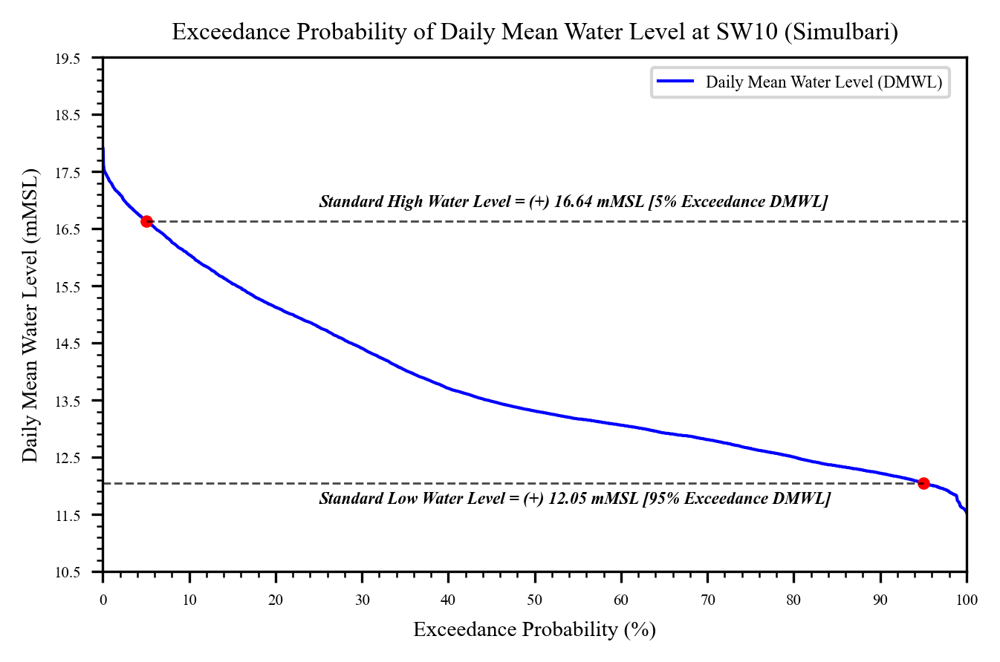

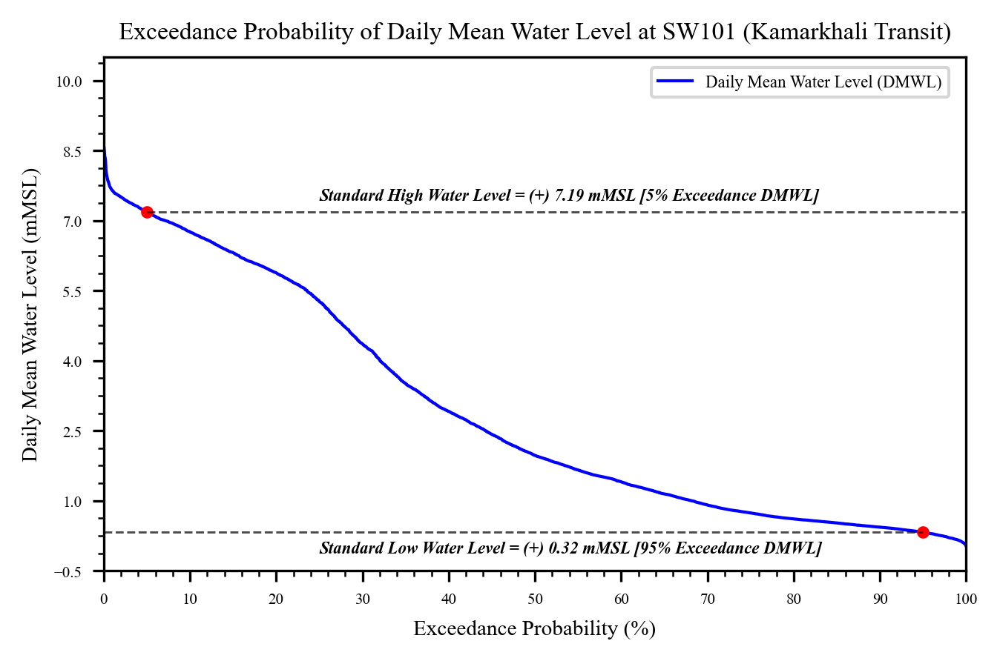

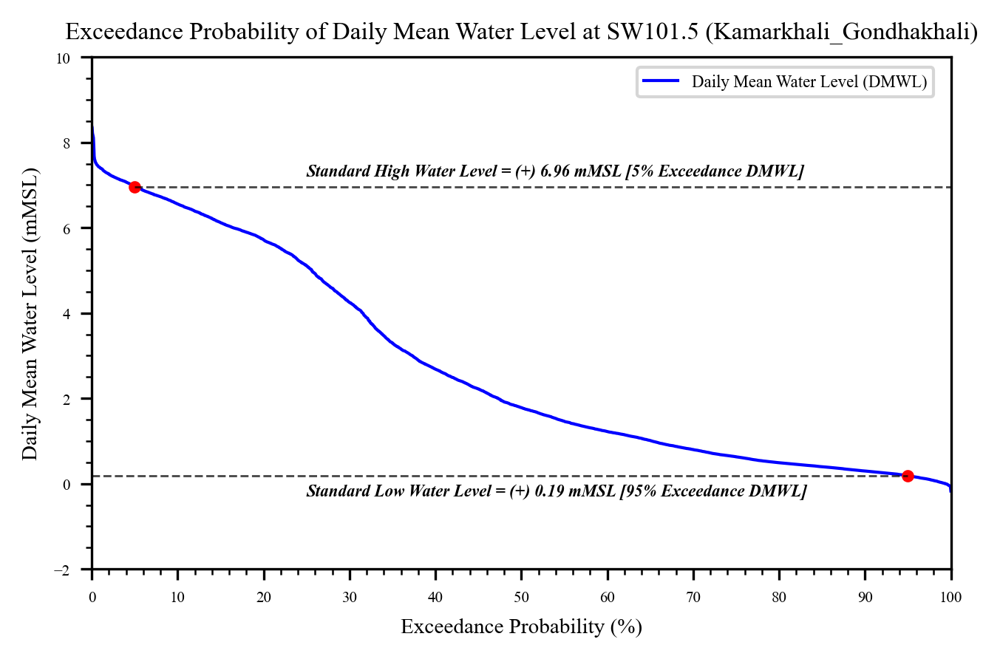

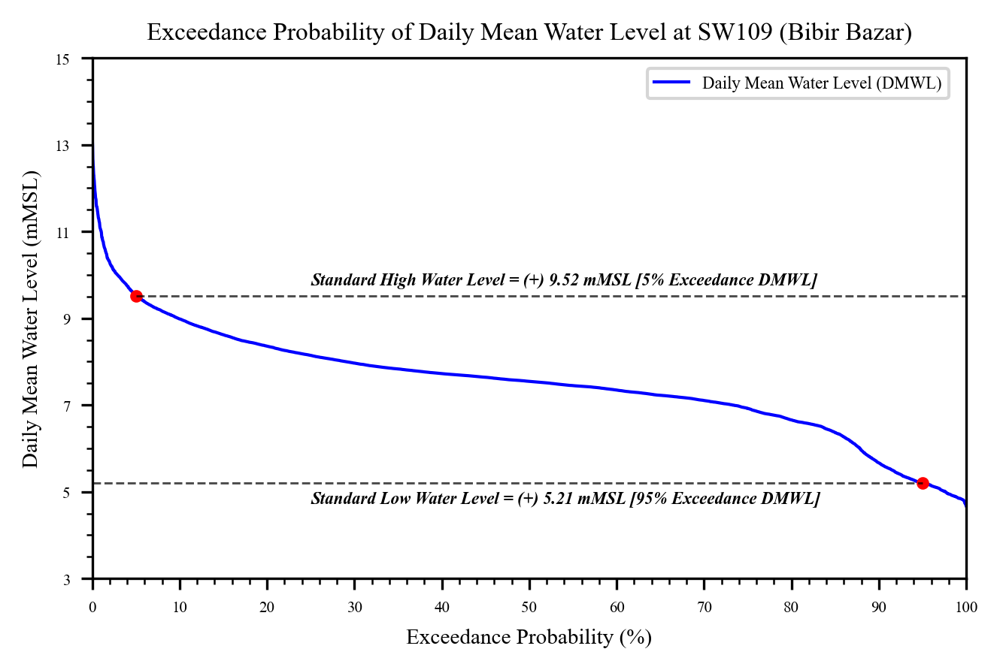

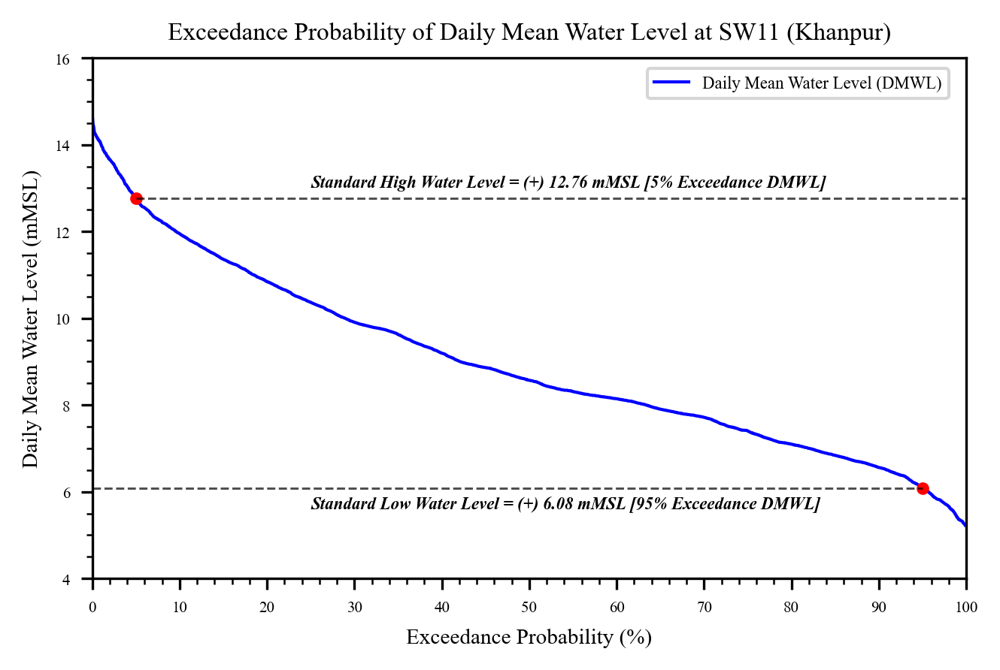

...

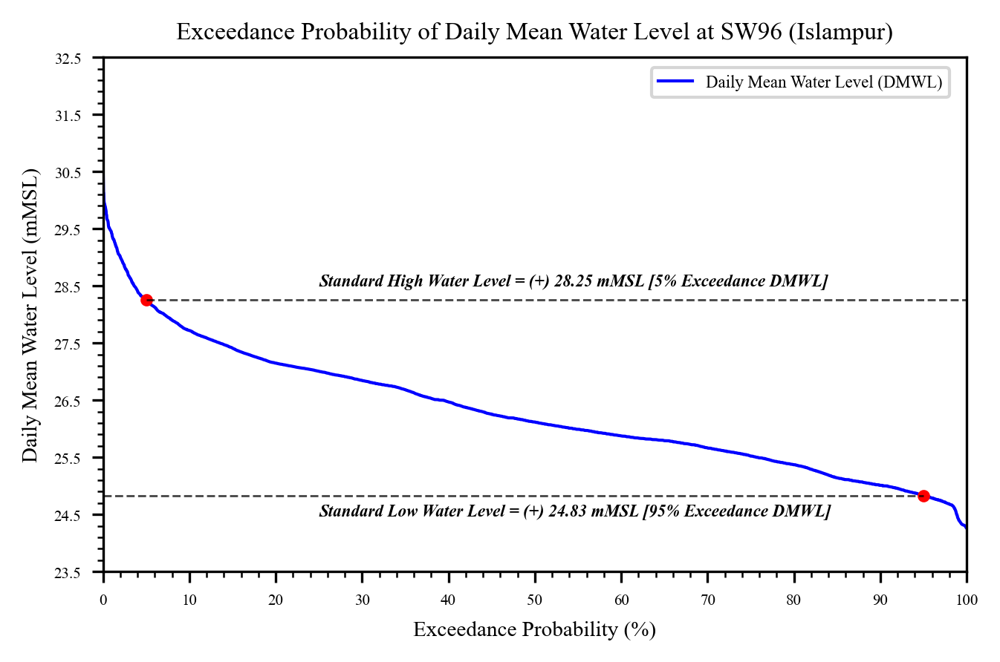

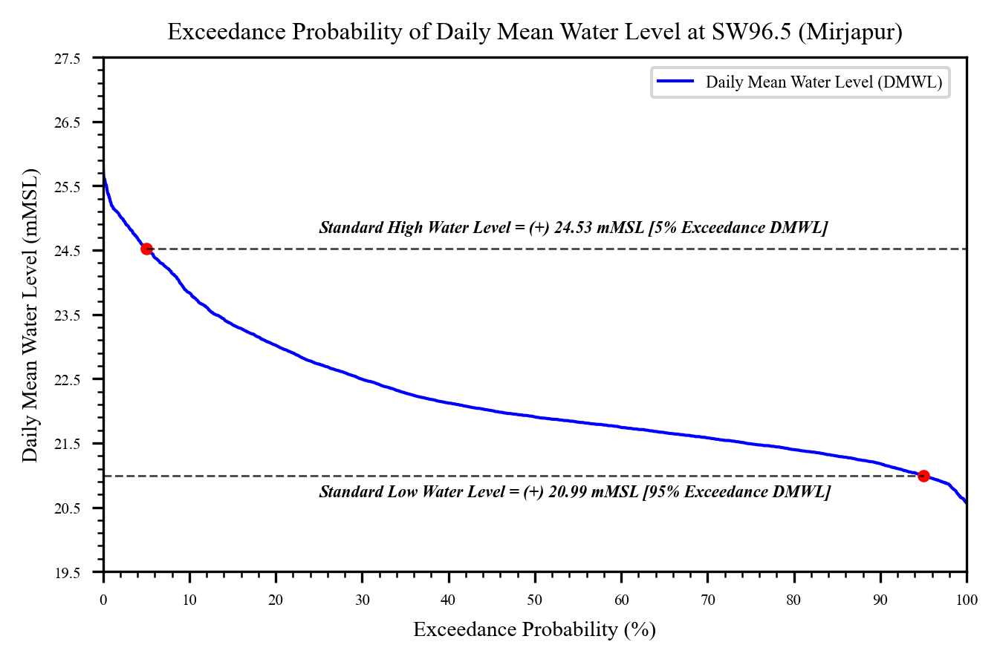

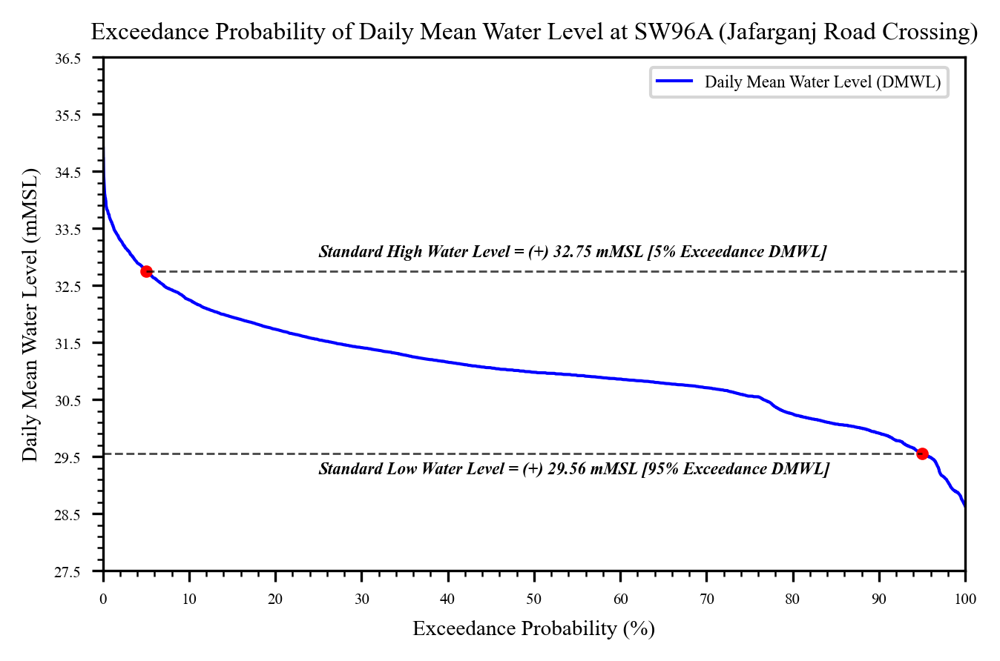

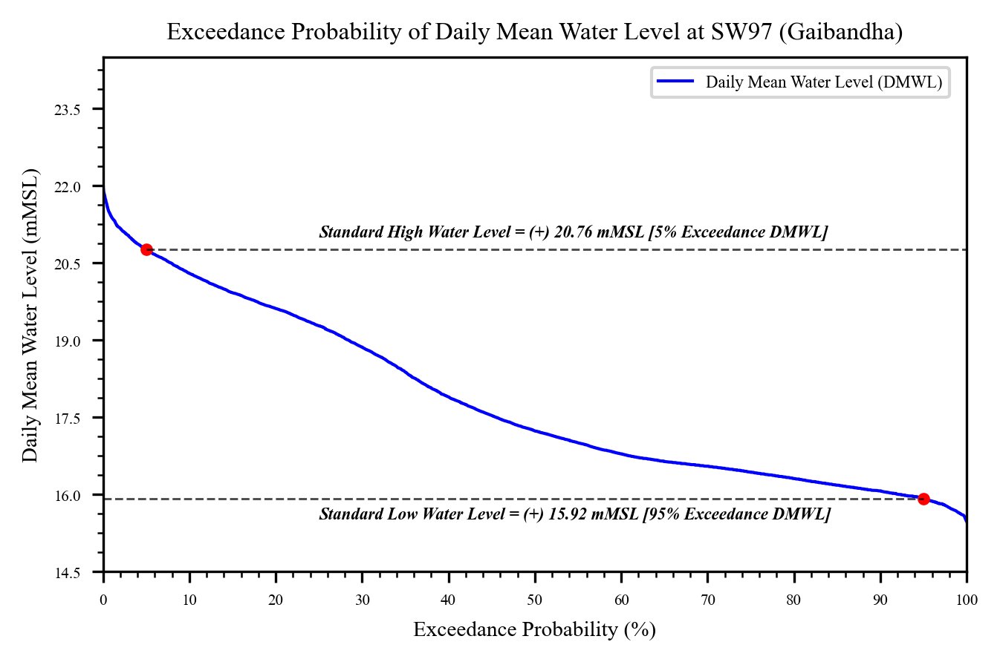

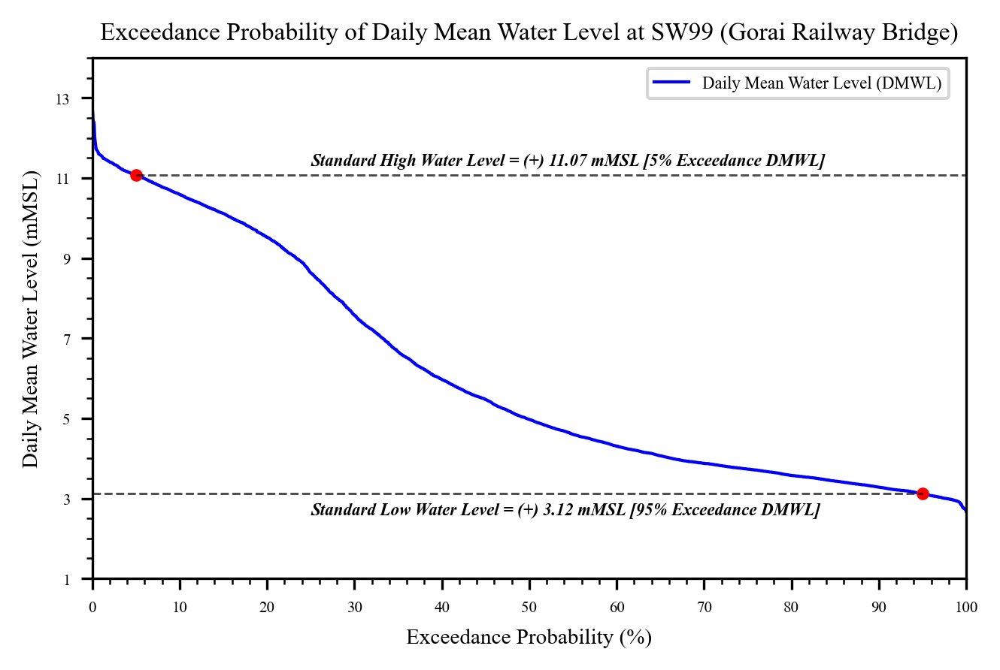

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import math
import os
import glob

e_df = pd.DataFrame()

for file in glob.glob(r'G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\Daily_Avg\*.xlsx'):
    
    try:
        path_list = file.split(os.sep)

        df = pd.read_excel(file)

        #Exceedance Probability Calculation
        
        col_name = 'Data for Analysis (mMSL)'

        df.dropna(subset=[col_name],inplace = True)
        df.sort_values(by = col_name, ascending=False, inplace = True)
        df['Ranking'] = df[col_name].rank(method='min', ascending=False)
        df['Exceedence Probability (%)'] = (df.loc[:,'Ranking']*100)/(len(df[col_name])+1)


        # Exceedance Probability Plotting

        font={'family':'Times New Roman',
             'weight':'normal',
             'size':5.5}

        plt.rc('font',**font)
        plt.rc('xtick',labelsize=5)
        plt.rc('ytick',labelsize=5)

        plt.figure(figsize=(5,3),dpi=300)

        x_axis = df['Exceedence Probability (%)']  # input
        y_axis = df[col_name]                # input

        plt.plot(x_axis, y_axis,lw=1,color='blue',label='Daily Mean Water Level (DMWL)')
        plt.minorticks_on()

        y_min = math.floor(y_axis.min())
        y_max = math.ceil(y_axis.max())
        
        ytic_round_value = math.floor(((y_max-y_min)/5)*2)/2
        
        if math.floor(ytic_round_value/2) == 0:
            y_low = y_min - math.floor(ytic_round_value/2) - 0.5
            y_high =  y_max + math.ceil(ytic_round_value/2) + 0.5
            
        else:
            y_low = y_min - math.floor(ytic_round_value/2)
            y_high =  y_max + math.ceil(ytic_round_value/2)
        # low,high=round(df3['WL (mMSL)'].min())-1,round(df3['WL (mMSL)'].max())+1



        plt.legend(bbox_to_anchor=(0.98, 0.98), loc=1, borderaxespad=0)

        plt.xticks(np.arange(0,100+1,10))
        plt.yticks(np.arange(y_low,y_high+0.1,ytic_round_value))

        plot_title = 'Exceedance Probability of Daily Mean Water Level at {}'.format(path_list[-1][:-18])     # name needs to be changed
        plt.title(plot_title, fontweight= 'roman', fontsize = 8)
        plt.xlabel('Exceedance Probability (%)', fontweight= 'roman', fontsize = 7)
        plt.ylabel('Daily Mean Water Level (mMSL)', fontweight= 'roman', fontsize = 7)

        plt.xlim([0, 100])
        plt.ylim([y_low, y_high])


        xvals = [5, 95]
        yinterp = np.interp(xvals, x_axis, y_axis)


        # Update 5% and 95% WL value in the final Excel

        prob_df = pd.DataFrame({'Station Name': path_list[-1][:-18], 'Exceedance Probability (%)':xvals, 
                                   'WL (mMSL)': list(yinterp) })

        e_df = pd.concat([e_df,prob_df])


        # Adding 5% and 95% WL Points in the figure
        plt.plot(xvals, yinterp, 'o', color='r', markersize=3)


        # draw dash lines for 5% exceedance level
        plt.plot([xvals[0],100], [yinterp[0], yinterp[0]], '--', color='k', lw=0.7, alpha = 0.7)

        anot_label_1 = 'Standard High Water Level = (+) {b} mMSL [5% Exceedance DMWL]'.format(a=xvals[0],
                                                                                              b = "%.2f" % yinterp[0])

        plt.annotate(anot_label_1, (25, yinterp[0]+0.25), color='k',weight = 'bold', style='italic')


        # draw dash lines for 95% exceedance level
        plt.plot([0, xvals[1]], [yinterp[1], yinterp[1]], '--', color='k', lw=0.7, alpha = 0.7)

        anot_label_2 = 'Standard Low Water Level = (+) {b} mMSL [95% Exceedance DMWL]'.format(a=xvals[1],
                                                                                              b = "%.2f" % yinterp[1])

        plt.annotate(anot_label_2, (25, yinterp[1]-0.6*(y_high-y_low)/(22-7)), color='k',weight = 'bold', style='italic')



        #Saving the figure
        # plt.savefig(r"{}.jpg".format('test'), bbox_inches='tight')
        plt.savefig(r"G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\Plot\{}_EP.jpg".format(path_list[-1][:-5]), 
                    bbox_inches='tight')


        # Saving Exccedence Probability Calculation
        ep_cal_df = df[['Date',col_name,'Ranking','Exceedence Probability (%)']]
        ep_cal_df.to_excel(r"G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\EP_Calculation\{}_EP.xlsx".format(path_list[-1][:-5]), 
                           float_format="%.4f")
    
        print(path_list[-1][:-5])
        
        
    except:
        print('Error!!_' + path_list[-1][:-5])


# Saving 5% and 95% Exceedance Probability Plot of Input Station
e_df.to_excel(r"G:\MJI\SHWL_SLWL\Updated Analysis\BWDB _WL_Stations\Non_Tidal\Output\BWDB_Non_Tidal_Stations_SHWL_and_SLWL.xlsx", 
              float_format="%.4f", index = None)